In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
%matplotlib inline
from PIL import Image
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
import torch.nn.functional as F
from torchvision.datasets import DatasetFolder


# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

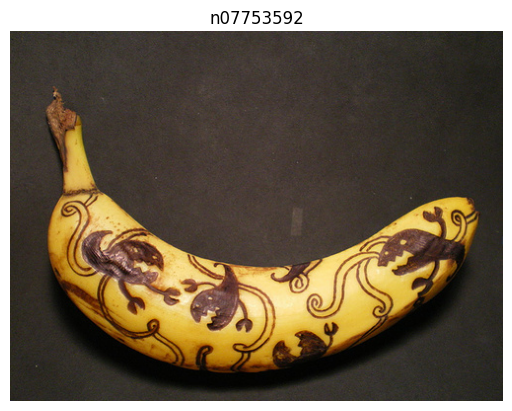

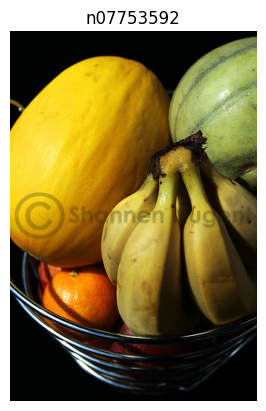

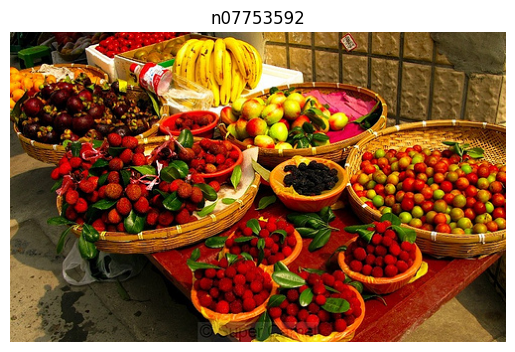

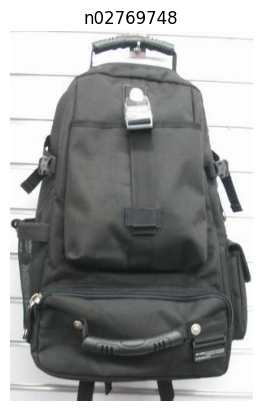

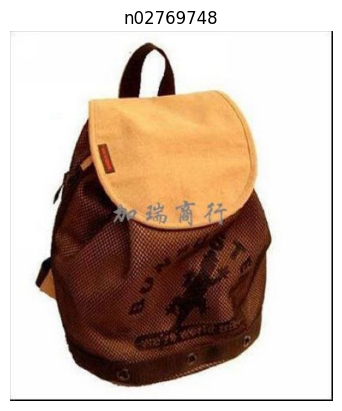

...

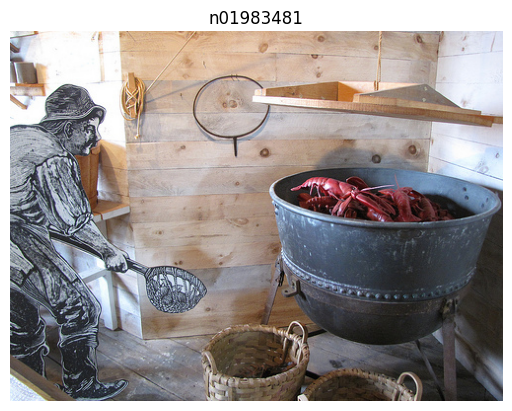

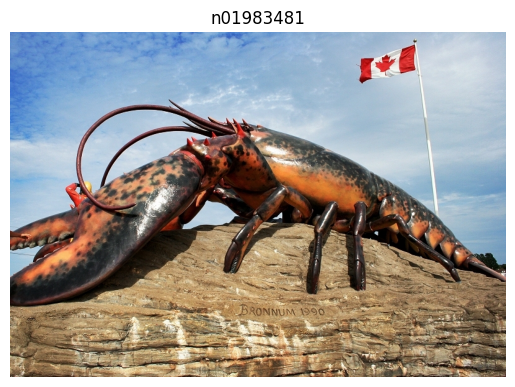

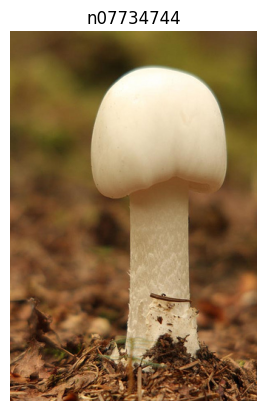

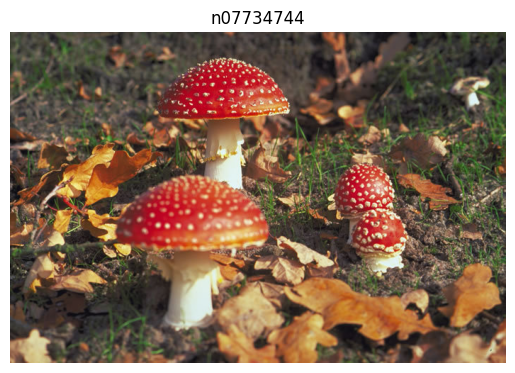

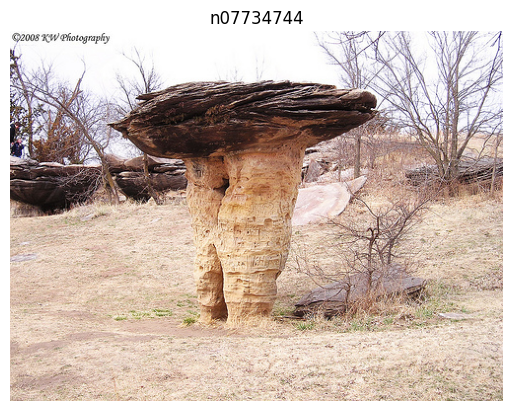

In [ ]:
#Plotting images
classes = os.listdir("/kaggle/input/iith-dl-contest-2024/train/train")
count = 3
i=0
for clas in classes:
    class_fol = os.path.join("/kaggle/input/iith-dl-contest-2024/train/train", clas)
    images = os.listdir(class_fol)[:count]

    for image in images:
        path = os.path.join(class_fol, image)
        img = Image.open(path)

        plt.imshow(img)
        plt.title(clas)
        plt.axis('off')
        plt.show()
    i+=1

    if i>20:
        break

In [5]:
class CreateDataset(Dataset):
    def __init__(self, ddir, transform=None):
        self.ddir = ddir
        self.classes = sorted(os.listdir(ddir))
        self.class_to_idx = {cls_name: idx for idx, cls_name in enumerate(self.classes)}
        self.images = self.load_images()
        self.transform = transform

    def load_images(self):
        images = []
        for cls_name in self.classes:
            class_dir = os.path.join(self.ddir, cls_name)
            for img_name in os.listdir(class_dir):
                img_path = os.path.join(class_dir, img_name)
                images.append((img_path, self.class_to_idx[cls_name]))
        return images

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path, label = self.images[idx]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, label


In [6]:
transform = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(30),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [ ]:
ddir = '/kaggle/input/iith-dl-contest-2024/train/train'
dataset = CreateDataset(ddir, transform=transform)
dataloader = DataLoader(dataset, batch_size=32, shuffle=True)

In [ ]:
class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels, expand_ratio, stride=1):
        super(ConvBlock, self).__init__()
        self.stride = stride
        hidden_dim = in_channels * expand_ratio
        self.expand = nn.Conv2d(in_channels, hidden_dim, kernel_size=1, bias=False)
        self.expand_bn = nn.BatchNorm2d(hidden_dim)
        self.depthwise = nn.Conv2d(hidden_dim, hidden_dim, kernel_size=3, stride=stride, padding=1, groups=hidden_dim, bias=False)
        self.depthwise_bn = nn.BatchNorm2d(hidden_dim)
        self.project = nn.Conv2d(hidden_dim, out_channels, kernel_size=1, bias=False)
        self.project_bn = nn.BatchNorm2d(out_channels)
        self.use_residual = stride == 1 and in_channels == out_channels

    def forward(self, x):
        out = F.relu6(self.expand_bn(self.expand(x)))
        out = F.relu6(self.depthwise_bn(self.depthwise(out)))
        out = self.project_bn(self.project(out))
        if self.use_residual:
            out += x
        return out

class EfficientNet(nn.Module):
    def __init__(self, num_classes=1000):
        super(EfficientNet, self).__init__()
        self.stem = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=3, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(32),
            nn.ReLU6(inplace=True)
        )
        self.blocks = nn.ModuleList([
            ConvBlock(in_channels=32, out_channels=16, expand_ratio=1, stride=1),
            ConvBlock(in_channels=16, out_channels=24, expand_ratio=6, stride=2),
            ConvBlock(in_channels=24, out_channels=24, expand_ratio=6, stride=1),
            ConvBlock(in_channels=24, out_channels=32, expand_ratio=6, stride=2),
            ConvBlock(in_channels=32, out_channels=32, expand_ratio=6, stride=1),
            ConvBlock(in_channels=32, out_channels=64, expand_ratio=6, stride=2),
            ConvBlock(in_channels=64, out_channels=64, expand_ratio=6, stride=1),
            ConvBlock(in_channels=64, out_channels=128, expand_ratio=6, stride=2),
            ConvBlock(in_channels=128, out_channels=128, expand_ratio=6, stride=1),
            ConvBlock(in_channels=128, out_channels=256, expand_ratio=6, stride=2),
            ConvBlock(in_channels=256, out_channels=256, expand_ratio=6, stride=1)
        ])
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.dropout = nn.Dropout(0.2)
        self.fc = nn.Linear(256, num_classes)

    def forward(self, x):
        x = self.stem(x)
        for block in self.blocks:
            x = block(x)
        x = self.avg_pool(x)
        x = x.flatten(1)
        x = self.dropout(x)
        x = self.fc(x)
        return x


In [ ]:
model = EfficientNet(num_classes=len(dataset.classes)).to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

start_epoch = 0
checkpoint_path = '/kaggle/working/checkpoint_epoch.pth'
if os.path.exists(checkpoint_path):
    checkpoint = torch.load(checkpoint_path)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    start_epoch = checkpoint['epoch'] + 1
    start_loss = checkpoint['loss']
    print(f"Checkpoint loaded. Resuming from epoch {start_epoch}, loss: {start_loss:.4f}")
else:
    start_epoch = 0
    start_loss = None


num_epochs = 100

for epoch in range(start_epoch, num_epochs):
    print(f'Epoch {epoch+1}/{num_epochs}')
    print('-' * 10)
    running_loss = 0.0

    for images, labels in dataloader:
        images = images.to(device)
        labels = labels.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * images.size(0)

    epoch_loss = running_loss / len(dataset)
    print(f'Loss: {epoch_loss:.4f}')

    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'loss': epoch_loss
    }, checkpoint_path)


In [ ]:
class TestDataset(Dataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.images = sorted(os.listdir(data_dir))
        self.transform = transform

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.data_dir, self.images[idx])
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, self.images[idx]



In [ ]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
]

In [ ]:
test_data_dir = '/kaggle/input/iith-dl-contest-2024/test/test'
test_dataset = TestDataset(test_data_dir, transform=transform)

test_dataloader = DataLoader(test_dataset, batch_size=32, shuffle=False)

model = EfficientNet(num_classes=len(dataset.classes)).to(device)
model.load_state_dict(torch.load(checkpoint_path)['model_state_dict'])
model.eval()

predictions = []

with torch.no_grad():
    for images, image_ids in test_dataloader:
        images = images.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)
        predicted_classes = [dataset.classes[p.item()] for p in predicted]
        predictions.extend(zip(image_ids, predicted_classes))

output_file_path = '/kaggle/working/predictions6.csv'

with open(output_file_path, 'w') as f:
    f.write("ID,Category\n")
    for image_id, predicted_class in predictions:
        f.write(f"{image_id},{predicted_class}\n")

print(f"Predictions saved to {output_file_path}")